In [1]:
import pandas as pd 
import numpy as np
from datetime import datetime, timedelta
from py_vollib.black_scholes.implied_volatility import implied_volatility

# import py_vollib.black_scholes_merton.implied_volatility
# import py_vollib_vectorized  

import plotly.graph_objs as go
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

from tqdm import tqdm

import datetime
import mibian

from utils import  *

In [2]:
start_date = '2019-02-11'

In [3]:
spot_path = 'Data/NIFTY_SPOT.csv' #'Data/NIFTY_Spot.csv'
ce_path   = 'Data/CE.csv'
pe_path   = 'Data/PE.csv'

df_spot   = pd.read_csv(spot_path)  #pd.read_csv('Data/NIFTY_1.csv', index_col=0, parse_dates=True) #
df_ce     = pd.read_csv(ce_path,index_col=[0])
df_pe     = pd.read_csv(pe_path,index_col=[0])

cols_to_drop = ['Open', 'High', 'Low', 'Volume', 'Open Interest']
df_ce.drop(cols_to_drop, axis=1, inplace=True)
df_pe.drop(cols_to_drop, axis=1, inplace=True)

df_spot.rename(columns = {'DATE':'Date','TIME':'Time','OPEN':'Open','HIGH':'High','LOW':'Low','CLOSE':'Close','VOLUME':'Volume'},inplace = True)

In [4]:
df_pe.head()

,Instrument,Option Type,Date,Expiry,Strike price,Time,Close,index
0,NIFTY,PE,2019-02-11,2019-02-14,10000,09:18:00,1.35,NaN
1,NIFTY,PE,2019-02-11,2019-02-14,10000,09:20:00,0.95,NaN
2,NIFTY,PE,2019-02-11,2019-02-14,10000,09:29:00,0.65,NaN
3,NIFTY,PE,2019-02-11,2019-02-14,10000,09:30:00,0.80,NaN
4,NIFTY,PE,2019-02-11,2019-02-14,10000,09:31:00,0.80,NaN


In [5]:
df_spot['Datetime'] = df_spot['Date'] + ' ' + df_spot['Time']
df_ce['Datetime'] = df_ce['Date'] + ' ' + df_ce['Time']
df_pe['Datetime'] = df_pe['Date'] + ' ' + df_pe['Time']

df_spot['Datetime'] = pd.to_datetime(df_spot['Datetime'])
df_ce['Datetime'] = pd.to_datetime(df_ce['Datetime'])
df_pe['Datetime'] = pd.to_datetime(df_pe['Datetime'])

df_spot.set_index('Datetime',inplace=True)
df_ce.set_index('Datetime',inplace=True)
df_pe.set_index('Datetime',inplace=True)

df_spot = df_spot[df_spot.index >= pd.to_datetime(start_date + ' ' + '09:15:00')].sort_index()
# df_ce = df_ce[df_ce.index >= pd.to_datetime(start_date + ' ' + '09:15:00')].sort_index()
# df_pe = df_pe[df_pe.index >= pd.to_datetime(start_date + ' ' + '09:15:00')].sort_index()


df_ce.drop(['index'],axis=1,inplace=True)
df_pe.drop(['index'],axis=1,inplace=True)

In [6]:
# from py_vollib.black_scholes import black_scholes as bs
# from py_vollib.black_scholes.greeks.analytical import vega


# def implied_vol_nr(S0, K, T, r, market_price, flag='c', tol=0.00001):
#     """Compute the implied volatility of a European Option
#         S0: initial stock price
#         K:  strike price
#         T:  maturity
#         r:  risk-free rate
#         market_price: market observed price
#         tol: user choosen tolerance
#     """
#     max_iter = 200 #max number of iterations
#     vol_old = 0.30 #initial guess
#     for k in range(max_iter):
#         bs_price = bs(flag, S0, K, T, r, vol_old)
#         Cprime =  vega(flag, S0, K, T, r, vol_old)*100
#         C = bs_price - market_price
#         vol_new = vol_old - C/Cprime
#         bs_new = bs(flag, S0, K, T, r, vol_new)
#         if (abs(vol_old - vol_new) < tol or abs(bs_new - market_price) < tol):
#             break
#         vol_old = vol_new
#     implied_vol = vol_old
#     return implied_vol * 100

In [7]:
df_spot.head()

,Unnamed: 0,ASSET,Date,Time,Open,High,Low,Close,Volume
Datetime,,,,,,,,,
2019-02-11 09:15:00,195201,NIFTY,2019-02-11,09:15:00,10924.20,10924.45,10896.60,10897.85,0.0
2019-02-11 09:16:00,195202,NIFTY,2019-02-11,09:16:00,10897.55,10897.55,10883.65,10893.90,0.0
2019-02-11 09:17:00,195203,NIFTY,2019-02-11,09:17:00,10892.50,10895.80,10888.75,10892.35,0.0
2019-02-11 09:18:00,195204,NIFTY,2019-02-11,09:18:00,10892.40,10895.25,10887.35,10895.25,0.0
2019-02-11 09:19:00,195205,NIFTY,2019-02-11,09:19:00,10893.95,10900.85,10892.05,10900.85,0.0


In [8]:
df_ce.head()

,Instrument,Option Type,Date,Expiry,Strike price,Time,Close
Datetime,,,,,,,
2019-02-11 09:18:00,NIFTY,CE,2019-02-11,2019-02-14,10000,09:18:00,910.0
2019-02-11 09:48:00,NIFTY,CE,2019-02-11,2019-02-14,10000,09:48:00,888.5
2019-02-11 09:58:00,NIFTY,CE,2019-02-11,2019-02-14,10000,09:58:00,869.9
2019-02-11 10:19:00,NIFTY,CE,2019-02-11,2019-02-14,10000,10:19:00,882.9
2019-02-11 11:11:00,NIFTY,CE,2019-02-11,2019-02-14,10000,11:11:00,877.8


In [9]:
df_ce = df_ce.sort_index()
df_pe = df_pe.sort_index()

In [13]:
window = 5
sampling_interval = 15 ## in minutes

columns = ['Datetime', 'Instrument', 'Date', 'Expiry', 'Time', 'Price', 'IV_ITM_5', 'IV_ITM_4', 'IV_ITM_3', 'IV_ITM_2', 'IV_ITM_1', 'IV_ATM', 'IV_OTM_1', 'IV_OTM_2', 'IV_OTM_3', 'IV_OTM_4', 'IV_OTM_5', 'Time to Expiry']

# Create an empty dataframe with the specified columns
iv_df = pd.DataFrame(columns=columns)

for index, row in df_spot.iterrows():
    datetime_index = index
    if datetime_index.minute % sampling_interval == 0:
        print(datetime_index)
        ivs = []
        # ivs_mibian = []
        # ivs_nr = []
        # ivs_4 = []
        
        date = index.date()
        time = index.time()
        
        price = row['Close']
        # Fetch corresponding data from df_ce based on the same datetime index
        
        try:
            ce_data = df_ce.loc[index]
            pe_data = df_pe.loc[index]
        except:
            ce_data = None
            pe_data = None
        
        
        # print('CE Data: ', ce_data, 'PE Data: ', ce_data)
        
        if ce_data is not None and pe_data is not None:
            # ce_data = df_ce.loc[index]
            # option_type = ce_data['Option Type'].values[0]
            assert ce_data.Expiry.values[0] == pe_data.Expiry.values[0]
            expiry = ce_data.Expiry.values[0]
            asset = ce_data.Instrument.values[0]
            atm_strike, prices_below, prices_above = CalculateStrikes(price, window=window)
            # print(atm_strike, prices_below[::-1], prices_above)
            strike_list =  prices_below[::-1] + [atm_strike] + prices_above
            # print('Current Price: ', price)
            # print('Strike List: ', strike_list)
            
            curr_time = datetime_index
            expiry = ce_data.Expiry.values[0]  + ' ' + '15:30:00'
            print('Current Time %s Expiry %s', str(curr_time), str(expiry))
            
            time_to_exp = TimeToExpiry(str(curr_time),str(expiry))
            
            # py_vollib_vectorized.vectorized_implied_volatility_black(price, F, K, r, t, flag, return_as='numpy') 
            # print(time_to_exp)
            for strike in strike_list:
                # print(sorted(ce_data['Strike price'].values.tolist()), strike, type(strike))
                
                
                # time_to_exp = 0.5
                # premium = 500
                
                # print('Premium %.2f Price %.2f Strike %.2f Time to Expiry %.6f' % (premium, price, strike, time_to_exp))
                
                if ce_data[ce_data['Strike price'] == strike].Close.values.tolist() and pe_data[pe_data['Strike price'] == strike].Close.values.tolist():     
                
                    try:
                        if strike < price:
                            premium = pe_data[pe_data['Strike price'] == strike].Close.values[0]
                            iv = implied_volatility(premium, price, strike, time_to_exp, r=0.1, flag='p')*100
                        else:
                            premium = ce_data[ce_data['Strike price'] == strike].Close.values[0]
                            iv = implied_volatility(premium, price, strike, time_to_exp, r=0.1, flag='c')*100
                    except:
                        iv = 0
                    # else:
                    #     # print('a')
                    #     iv = implied_volatility(premium, price, strike, time_to_exp, r=0.1, flag='c')*100
                
                else:
                    premium = 0
                    iv = 0
                
                print('Datetime %s Premium %.2f Price %.2f Strike %.2f Time to Expiry %.6f IV %.2f' % (str(index), premium, price, strike, time_to_exp, iv))
                # print('Price %.2f Strike %.2f IV %.2f' % (price, strike, iv))
                # iv_meb = mibian.BS([price, strike, 10, time_to_exp*365], callPrice=premium)
                # print('nr', price, strike, time_to_exp, 0.1, premium)
                # iv_nr = implied_vol_nr(price, strike, time_to_exp, 0.1, premium, flag='c')
                # iv4 = implied_vol(premium, price, strike, time_to_exp*365, 0.1) * 100
                
                # if iv_nr < 0:
                #     iv_nr = 0
                # print('iv: ', iv4)
                
                # ivs.append(iv)
                # ivs_nr.append(iv_nr)
                # ivs.append(iv.impliedVolatility)
                ivs.append(iv)
                # ivs_4.append(iv4)
            row_values = [index, asset, date, expiry, time, price] + ivs + [time_to_exp] 
            
            # iv_df = iv_df.append(pd.Series(row_values, index=iv_df.columns), ignore_index=True)
            iv_df.loc[len(iv_df)] = row_values
            # print(iv_df.shape)
            
            # print(row_values)
            # plt.plot(strike_list, ivs_4)
            # plt.plot(strike_list, ivs)
            # plt.plot(strike_list,[0]*5+ivs_nr[-6:])
            # plt.plot(strike_list, ivs_mibian)
            # plt.legend(['4', 'BS', 'NR', 'Mibian'])
            # plt.show()
            # break
        
    # if iv_df.shape[0] >= 10:
    #     break

iv_df.head()

2019-02-11 09:15:00
Current Time %s Expiry %s 2019-02-11 09:15:00 2019-02-14 15:30:00
Datetime 2019-02-11 09:15:00 Premium 0.00 Price 10897.85 Strike 10650.00 Time to Expiry 0.008933 IV 0.00
Datetime 2019-02-11 09:15:00 Premium 0.00 Price 10897.85 Strike 10700.00 Time to Expiry 0.008933 IV 0.00
Datetime 2019-02-11 09:15:00 Premium 0.00 Price 10897.85 Strike 10750.00 Time to Expiry 0.008933 IV 0.00
Datetime 2019-02-11 09:15:00 Premium 0.00 Price 10897.85 Strike 10800.00 Time to Expiry 0.008933 IV 0.00
Datetime 2019-02-11 09:15:00 Premium 45.00 Price 10897.85 Strike 10850.00 Time to Expiry 0.008933 IV 17.09
Datetime 2019-02-11 09:15:00 Premium 64.00 Price 10897.85 Strike 10900.00 Time to Expiry 0.008933 IV 14.64
Datetime 2019-02-11 09:15:00 Premium 40.70 Price 10897.85 Strike 10950.00 Time to Expiry 0.008933 IV 14.45
Datetime 2019-02-11 09:15:00 Premium 26.95 Price 10897.85 Strike 11000.00 Time to Expiry 0.008933 IV 15.16
Datetime 2019-02-11 09:15:00 Premium 0.00 Price 10897.85 Strike 11

,Datetime,Instrument,Date,Expiry,Time,Price,IV_ITM_5,IV_ITM_4,IV_ITM_3,IV_ITM_2,IV_ITM_1,IV_ATM,IV_OTM_1,IV_OTM_2,IV_OTM_3,IV_OTM_4,IV_OTM_5,Time to Expiry
0,2019-02-11 09:15:00,NIFTY,2019-02-11,2019-02-14 15:30:00,09:15:00,10897.85,0.0,0.000000,0.000000,0.000000,17.090847,14.639462,14.452594,15.164853,0.000000,14.916689,0.000000,0.008933
1,2019-02-11 09:30:00,NIFTY,2019-02-11,2019-02-14 15:30:00,09:30:00,10877.25,0.0,17.603888,0.000000,17.461240,17.464575,14.435774,14.187856,13.861563,0.000000,13.098138,0.000000,0.008904
2,2019-02-11 09:45:00,NIFTY,2019-02-11,2019-02-14 15:30:00,09:45:00,10883.40,0.0,0.000000,0.000000,16.429088,16.241526,13.489549,0.000000,13.127366,12.460890,12.024439,0.000000,0.008876
3,2019-02-11 10:00:00,NIFTY,2019-02-11,2019-02-14 15:30:00,10:00:00,10863.35,0.0,0.000000,16.169978,0.000000,15.945147,15.672092,14.698478,14.330040,13.971128,13.240040,12.723871,0.008847
4,2019-02-11 10:15:00,NIFTY,2019-02-11,2019-02-14 15:30:00,10:15:00,10877.65,0.0,16.206091,0.000000,16.156158,16.045691,14.063999,13.784632,13.332267,0.000000,0.000000,0.000000,0.008818


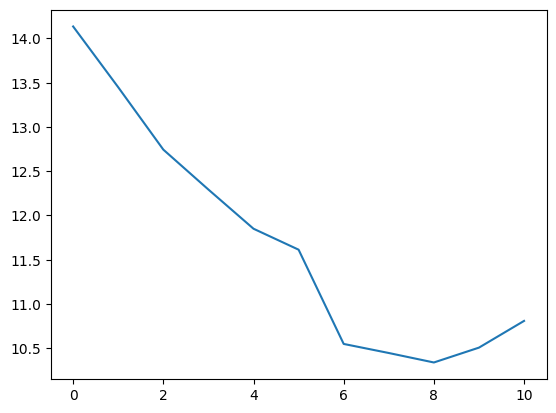

In [20]:
plt.plot(iv_df.iloc[25401, -12:-1].values.tolist())

In [19]:
iv_df.to_csv('Data/iv_data_nifty.csv', index=False)

In [39]:
iv_df['IV_ATM'].max()

209.80213802744814

Total Zeros:  88


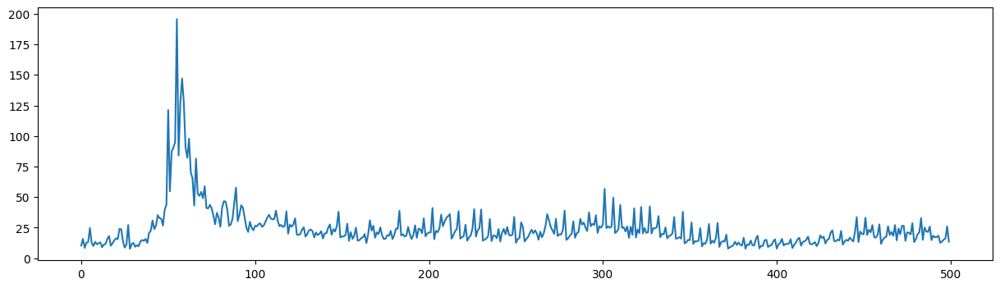

In [52]:
atm_series = iv_df['IV_ATM']
print('Total Zeros: ', atm_series.eq(0).sum())
atm_series = atm_series.replace(0, pd.NA)
atm_series = atm_series.dropna()

plt.figure(figsize=(15, 4))
plt.plot(atm_series.values.tolist()[::25][:500])

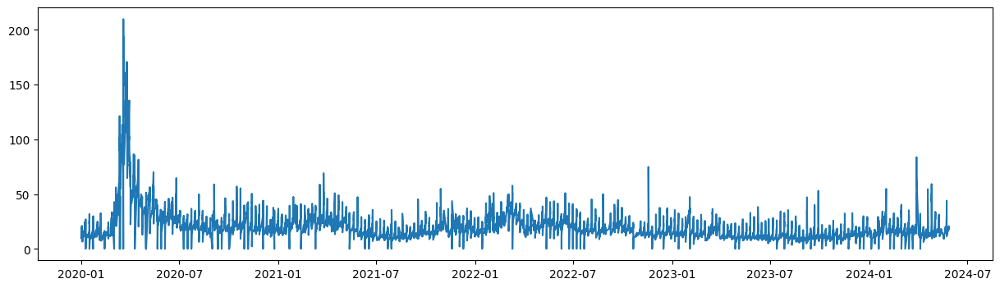

In [42]:
plt.figure(figsize=(15, 4))
plt.plot(iv_df['Datetime'], iv_df['IV_ATM'].values.tolist())

In [29]:
import numpy as np
from py_vollib.black_scholes_merton.implied_volatility import implied_volatility
from py_vollib.black_scholes_merton import black_scholes_merton

# Example option chain data
option_chain = [
    {'strike': 17200, 'price': 230, 'type': 'C'},
    {'strike': 17450, 'price': 7, 'type': 'C'},
    {'strike': 17600, 'price': 5, 'type': 'C'},
    # Add more options as needed
]

# Market data
underlying_price = 17428.90  # Example underlying asset price
risk_free_rate = 0.01   # Example risk-free interest rate (1%)
time_to_expiration = 1 / 365  # Example time to expiration in years (30 days)

def calculate_implied_volatility(option_chain, underlying_price, risk_free_rate, time_to_expiration):
    ivs = []
    for option in option_chain:
        strike = option['strike']
        price = option['price']
        option_type = option['type']

        try:
            iv = implied_volatility(price, underlying_price, strike, time_to_expiration, risk_free_rate, 0, option_type.lower())
            ivs.append({'strike': strike, 'implied_volatility': iv})
        except Exception as e:
            ivs.append({'strike': strike, 'implied_volatility': None, 'error': str(e)})
    
    return ivs

# Calculate the implied volatilities
implied_vols = calculate_implied_volatility(option_chain, underlying_price, risk_free_rate, time_to_expiration)

# Print the results
for iv in implied_vols:
    print(f"Strike: {iv['strike']}, Implied Volatility: {iv['implied_volatility']}")



Strike: 17200, Implied Volatility: 0.11849883717984586
Strike: 17450, Implied Volatility: 0.04154077099424351
Strike: 17600, Implied Volatility: 0.13670719977675266


In [66]:
import numpy as np
from scipy.stats import norm
from scipy.optimize import minimize_scalar   
import pandas as pd
# import pandas_datareader.data as web
import datetime as dt
N = norm.cdf

def BS_CALL(S, K, T, r, sigma):
    d1 = (np.log(S/K) + (r + sigma**2/2)*T) / (sigma*np.sqrt(T))
    d2 = d1 - sigma * np.sqrt(T)
    return S * N(d1) - K * np.exp(-r*T)* N(d2)

def BS_PUT(S, K, T, r, sigma):
    d1 = (np.log(S/K) + (r + sigma**2/2)*T) / (sigma*np.sqrt(T))
    d2 = d1 - sigma* np.sqrt(T)
    return K*np.exp(-r*T)*N(-d2) - S*N(-d1)    
    

def implied_vol(opt_value, S, K, T, r, type_='call'):
    
    def call_obj(sigma):
        return abs(BS_CALL(S, K, T, r, sigma) - opt_value)
    
    def put_obj(sigma):
        return abs(BS_PUT(S, K, T, r, sigma) - opt_value)
    
    if type_ == 'call':
        res = minimize_scalar(call_obj, bounds=(0.01,6), method='bounded')
        return res.x
    elif type_ == 'put':
        res = minimize_scalar(put_obj, bounds=(0.01,6),
                              method='bounded')
        return res.x
    else:
        raise ValueError("type_ must be 'put' or 'call'")

In [81]:
S = 144.65
K = 145
T = 30/365
r = 0.05
sigma = 0.45

# C = BS_CALL(S, K, T, r, sigma)
# print(C)
iv = implied_vol(3.89, S, K, T, r) * 100
print(iv)

22.789089155445446


In [19]:
3/365

0.00821917808219178

In [14]:

# We will now use the mibian library to calculate the implied volatility.
##The syntax for the variable values is in the format as mentioned below:
# BS([UnderlyingPrice, StrikePrice, InterestRate, Daystoexpiration],callPrice=x)
premium = 0.65
price = 24413.50
strike = 25600
time =  1/365.25 #0.003451
r = 0.1
# Python code:
c1 = implied_volatility(premium, price, strike, time, r=0.05, flag='c')*100
c2 = mibian.BS([price, strike, r*100, time*365], callPrice=premium)

# Input Code:
print(c1)
c2.impliedVolatility

34.69163641394764


34.60693359375

In [29]:
implied_vol_est = implied_vol(145.65, 145, 30/365, 0.05, 3.89, flag='c')
print("Implied Volatility is : ", round(implied_vol_est,5)*100, "%")

Implied Volatility is :  19.497999999999998 %
